# Experimental Analysis of Cellseq Adipose Tissue Macrophages

In this line of experimentation we had four experimental groups:
- Low Fat Diet
- High Fat Diet
- High Fat Diet + Schistosoma Egg Antigen (SEA)
- High Fat Diet + [Omega-1 Glycoprotein](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2722183/)

Two phases of analysis:

1. Is the transcriptome of SEA and omega-1-treated mice similar to one another, and more similar to LFD-fed mice than HFD-fed mice? 
2. Moreover, we would like to look at most differentially changed mRNAs in SEA-treated and omega-1-treated mice compared to näïve HFD-fed mice, to have some hints at which pathways these macrophages may use to improve tissue-specific insulin sensitivity. A gene ontology analysis might provide useful insight in what's happening in these macrophages.


# Data Preparation

In [1]:
#Data Handling
import numpy as np
import pandas as pd
from sklearn.preprocessing import minmax_scale
#Visualization
from matplotlib import pyplot as plt
%matplotlib inline
from IPython.display import display
import seaborn as sns
import plotly.offline as plotly
plotly.offline.init_notebook_mode()
from plotly.graph_objs import *
import plotly.figure_factory as FF
#Feature extraction
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.cluster.bicluster import SpectralBiclustering, SpectralCoclustering
#Clustering
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.decomposition import NMF
#Misc
from scipy.signal import argrelextrema
from math import floor
from os import listdir

In [2]:
metadata = pd.read_csv("sample_sheet_Patrick_AdiposeMacs.txt", sep="\t")
metadata["#id"] = metadata["#id"].astype(str)
metadata

,#id,flocell,series,lane,il_barcode,cel_barcode,project
0,2,CALW2ANXX,LFD,L001,pool,2,Patrick_AdiposeMacs
1,6,CALW2ANXX,HFD,L001,pool,3,Patrick_AdiposeMacs
2,7,CALW2ANXX,HFD,L001,pool,4,Patrick_AdiposeMacs
3,11,CALW2ANXX,HFD-SEA,L001,pool,5,Patrick_AdiposeMacs
4,12,CALW2ANXX,HFD-SEA,L001,pool,6,Patrick_AdiposeMacs
5,13,CALW2ANXX,HFD-SEA,L001,pool,7,Patrick_AdiposeMacs
6,14,CALW2ANXX,HFD-SEA,L001,pool,8,Patrick_AdiposeMacs
7,16,CALW2ANXX,HFD-pLex,L001,pool,9,Patrick_AdiposeMacs
8,17,CALW2ANXX,HFD-pLex,L001,pool,10,Patrick_AdiposeMacs
9,20,CALW2ANXX,HFD-pLex,L001,pool,12,Patrick_AdiposeMacs


In [3]:
#Import data from files
study_data = None
rmetadata = None
for fname in listdir("htseq_count/"):
    exp_id_long = fname.split("_")[4].split(".")[0]
    exp_id = exp_id_long.lstrip("0")
    exp_data = pd.read_csv("htseq_count/"+fname, sep="\t", header=None, names=["gene", str(exp_id)])
    exp_data.loc[len(exp_data)] = ["fname", fname]
    if study_data is None:
        study_data = exp_data
    else:      
        study_data = study_data.merge(exp_data, on="gene", how="outer")
#Clean up        
study_data.index = study_data["gene"].values
del study_data["gene"]
study_data = study_data.T
study_data = study_data.merge(metadata, left_index=True, right_on="#id")
study_data.index = study_data.apply(lambda x: x["#id"] + " " + x["series"], axis=1)
rmetadata = study_data.apply(lambda x: pd.Series([x["fname"], x["series"]]), axis=1)
study_data.to_csv("studydata.csv")
sample_readinfo = study_data.iloc[:,-12:-1]
study_data = study_data.iloc[:,:-12]
#Display dfs
#display(study_data.head())
#display(sample_readinfo.head())
#Sanity check
if study_data.isnull().sum().sum() != 0:
    print("Some genes missing from count file")

In [4]:
count_matrix = minmax_scale(study_data.as_matrix(), axis=0)
heatmap = Data([
    Heatmap(
        x = study_data.columns, 
        y = study_data.index,
        z = count_matrix,
        colorscale='Viridis'
    )
])
layout = Layout(
    title='Gene Expression Heatmap',
    yaxis=dict(type="category"),
    margin=Margin(l=100)
)
fig = Figure(data=heatmap, layout=layout)
plotly.iplot(fig)

C:\Users\jpole\Anaconda3\lib\site-packages\sklearn\utils\validation.py:429: DataConversionWarning:

Data with input dtype object was converted to float64.



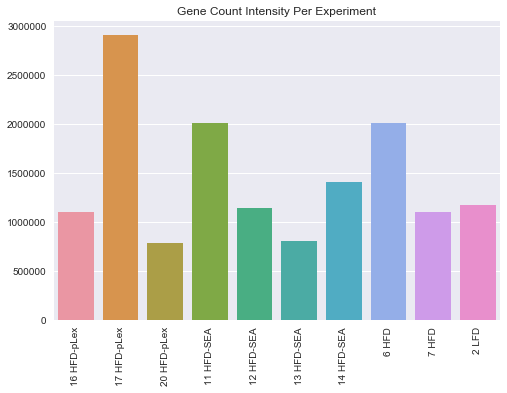

In [5]:
p = sns.barplot(study_data.index, study_data.sum(axis=1).as_matrix())
p.set_xticklabels(study_data.index, rotation=90)
plt.title("Gene Count Intensity Per Experiment")
plt.show()

In [6]:
norm_count_matrix = study_data.as_matrix() / study_data.sum(axis=1)[:, None]
norm_count_matrix = norm_count_matrix[:, norm_count_matrix.sum(axis=0) > 0]
norm_count_matrix = minmax_scale(norm_count_matrix)
print(count_matrix.shape, norm_count_matrix.shape)
heatmap = Data([
    Heatmap(
        x = study_data.columns, 
        y = study_data.index,
        z = norm_count_matrix,
        colorscale='Viridis'
    )
])
layout = Layout(
    title='Gene Expression Heatmap Normalized By Per Experiment Intensity',
    yaxis=dict(type="category"),
    margin=Margin(l=100)
)
fig = Figure(data=heatmap, layout=layout)
plotly.iplot(fig)

C:\Users\jpole\Anaconda3\lib\site-packages\sklearn\utils\validation.py:429: DataConversionWarning:

Data with input dtype object was converted to float64.



(10, 24422) (10, 15465)


# Principal Component Analysis and KMeans Clustering

In [7]:
def plotClusters(comp1, comp2, comp3, treatments, clusters, title=""):
    visrep = Scatter3d(
        x=comp1,
        y=comp2,
        z=comp3,
        text=treatments,
        mode='markers',
        marker=dict(
            size=12,
            color=clusters,
            colorscale='Viridis',
            opacity=0.8,
            line = dict(
                width = 0,
                color = "black"
            )
        )
    )
    fig = Figure(data=[visrep], layout=Layout(title=title))
    plotly.iplot(fig)

In [8]:
#PCA Decomposition to support later visualization
dim_red = PCA(n_components=10)
dim_red_genes = dim_red.fit_transform(norm_count_matrix)
print("% Variance Explained:", dim_red.explained_variance_ratio_.sum()*100)
plotClusters(dim_red_genes.T[0], dim_red_genes.T[1], dim_red_genes.T[2], 
             study_data.index, sample_readinfo["series"].astype("category").cat.rename_categories([0,1,2,3]), 
             "Experimental Groups on 3 PCs")

% Variance Explained: 100.0


In [9]:
#PCA Decomposition to support later visualization
dim_red = PCA(n_components=10)
dim_red_genes = dim_red.fit_transform(norm_count_matrix)
print("% Variance Explained:", dim_red.explained_variance_ratio_.sum()*100)
#K-Means Clustering
clf = KMeans(n_clusters=4)
clf.fit(dim_red_genes, sample_readinfo["series"])
serieshat = clf.predict(dim_red_genes)
plotClusters(dim_red_genes.T[0], dim_red_genes.T[1], dim_red_genes.T[2], study_data.index, serieshat, 
             "Experimental Groups on 3 PCs Colored by KMeans Clustering (n=4)")

% Variance Explained: 100.0


In [10]:
#NMF Decomposition
nmf_decomp = NMF(n_components=4)
nmf_genes = nmf_decomp.fit_transform(norm_count_matrix, sample_readinfo["series"])
heatmap = Data([
    Heatmap(
        y = study_data.index,
        z = np.asarray(nmf_genes),    
        colorscale = 'Viridis'
    )
])
layout = Layout(
    title='NMF Decomposition of Gene Expression Profiles',
    margin=Margin(l=100)
)
fig = Figure(data=heatmap, layout=layout)
plotly.iplot(fig)

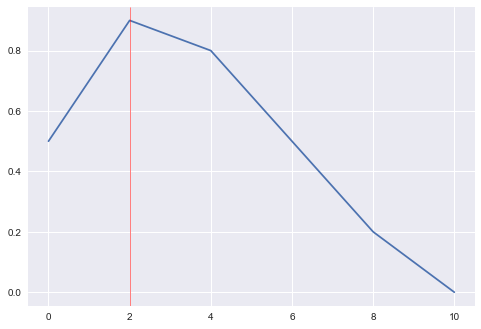

In [11]:
def nmf_cluster(nmf_data, threshold):
    nmf_data = pd.DataFrame(nmf_data)
    return nmf_data.apply(lambda x: x > threshold, axis=0);
step_size = 2;
min_val=0
max_val=10
tuning_range = np.arange(min_val, max_val+step_size, step_size);
order = .25*(max_val-min_val)/step_size
tuning_data = [(nmf_cluster(nmf_genes, i).sum(axis=1) == 1).sum()/nmf_genes.shape[0] for i in tuning_range]
plt.plot(tuning_range, tuning_data)
lextrema = argrelextrema(np.asarray(tuning_data), np.greater, order=floor(order))[0]
for lmin in tuning_range[lextrema]:
    plt.axvline(x=lmin, color="red", lw=.5)
plt.show()

In [12]:
heatmap = Data([
    Heatmap(
        y = study_data.index,
        z = np.asarray(nmf_cluster(nmf_genes, tuning_range[lextrema[0]])).astype(int),    
        colorscale = 'Viridis'
    )
])
layout = Layout(
    title='NMF Soft Clustering Assignments of Gene Expression Profiles',
    margin=Margin(l=100)
)
fig = Figure(data=heatmap, layout=layout)
plotly.iplot(fig)

In [23]:
biclust = SpectralCoclustering(n_clusters=4)
biclust.fit(norm_count_matrix)
fit_data = np.asarray(norm_count_matrix)[np.argsort(biclust.row_labels_)]
fit_data = fit_data[:, np.argsort(biclust.column_labels_)]

heatmap = Data([
    Heatmap(
        y = study_data.index[np.argsort(biclust.row_labels_)], 
        x = study_data.columns[np.argsort(biclust.column_labels_)],
        z = fit_data,    
        colorscale = 'Viridis'
    )
])
layout = Layout(
    title='Spectral BiClustering of Gene Expression Profiles',
    margin=Margin(l=100)
)
fig = Figure(data=heatmap, layout=layout)
plotly.iplot(fig)

In [ ]:
'''sns.distplot(np.std(norm_count_matrix, axis=0))
#Limit features
gene_filter = np.std(norm_count_matrix, axis=0) > .3
limited_study_data = study_data.loc[:, gene_filter]
limited_count_matrix = norm_count_matrix[:, gene_filter]
print(count_matrix.shape, limited_count_matrix.shape)'''

In [ ]:
'''heatmap = Data([
    Heatmap(
        x = limited_study_data.columns.values, 
        y = limited_study_data.index,
        z = limited_count_matrix,
        colorscale='Viridis'
    )
])
layout = Layout(
    title='Limited Gene Expression Heatmap',
    yaxis=dict(type="category")
)
fig = Figure(data=heatmap, layout=layout)
plotly.iplot(fig)'''

# Hierarchical Clustering

In [16]:
def clusterer(data, classes, labels, affinity_method, linkage_method):
    #Create crosstab
    Hclustering = AgglomerativeClustering(n_clusters=4, affinity=affinity_method, linkage=linkage_method)
    Hclustering.fit(data)
    ms = np.column_stack((classes, Hclustering.labels_))
    df = pd.DataFrame(ms, columns = ["Ground truth","Clusters"])
    display(pd.crosstab(df["Ground truth"], df["Clusters"], margins=True))
    #Plot dendrogram
    z = linkage(data, metric=affinity_method, method=linkage_method)
    dendrogram(z, labels=labels, orientation="left")
    plt.show()

Clusters,0,1,2,3,All
Ground truth,,,,,
HFD,0,2,0,0,2
HFD-SEA,4,0,0,0,4
HFD-pLex,0,0,3,0,3
LFD,0,0,0,1,1
All,4,2,3,1,10


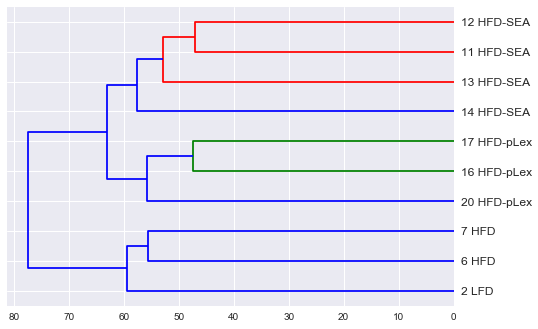

In [17]:
clusterer(norm_count_matrix, sample_readinfo["series"], study_data.index, "euclidean", "ward")

Clusters,0,1,2,3,All
Ground truth,,,,,
HFD,0,2,0,0,2
HFD-SEA,4,0,0,0,4
HFD-pLex,0,0,3,0,3
LFD,0,0,0,1,1
All,4,2,3,1,10


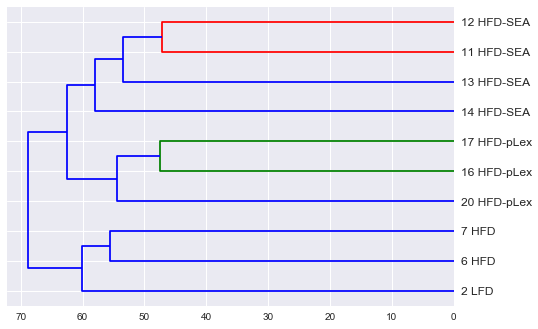

In [18]:
clusterer(norm_count_matrix, sample_readinfo["series"], study_data.index, "euclidean", "complete")

# Pairwise Distance Mapping

In [19]:
import plotly.plotly as py
from plotly.graph_objs import *
import plotly.figure_factory as FF

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
def dendromap(heatmap_func, title):
    # get data
    data_array = norm_count_matrix
    labels = study_data.index

    # Initialize figure by creating upper dendrogram
    figure = FF.create_dendrogram(data_array, orientation='bottom', labels=labels, 
                                  linkagefun=lambda x: linkage(data_array, 'ward', metric='euclidean'))
    for i in range(len(figure['data'])):
        figure['data'][i]['yaxis'] = 'y2'

    # Create Side Dendrogram
    dendro_side = FF.create_dendrogram(data_array, orientation='right',
                                       linkagefun=lambda x: linkage(data_array, 'ward', metric='euclidean'))
    for i in range(len(dendro_side['data'])):
        dendro_side['data'][i]['xaxis'] = 'x2'

    # Add Side Dendrogram Data to Figure
    figure['data'].extend(dendro_side['data'])

    # Create Heatmap
    dendro_leaves = dendro_side['layout']['yaxis']['ticktext']
    dendro_leaves = list(map(int, dendro_leaves))
    heat_data = heatmap_func(data_array)
    heat_data = heat_data[dendro_leaves,:]
    heat_data = heat_data[:,dendro_leaves]
    heat_data[heat_data == 0] = None
    heatmap = Data([
        Heatmap(
            x = dendro_leaves,
            y = study_data.index[dendro_leaves],
            z = heat_data,
            colorscale = 'YlGnBu'
        )
    ])

    heatmap[0]['x'] = figure['layout']['xaxis']['tickvals']
    heatmap[0]['y'] = dendro_side['layout']['yaxis']['tickvals']

    # Add Heatmap Data to Figure
    figure['data'].extend(Data(heatmap))

    # Edit Layout
    figure['layout'].update({'width':800, 'height':800,
                             'showlegend':False, 'hovermode': 'closest',
                             })
    # Edit xaxis
    figure['layout']['xaxis'].update({'domain': [.15, 1],
                                      'mirror': False,
                                      'showgrid': False,
                                      'showline': False,
                                      'zeroline': False,
                                      'ticks':""})
    # Edit xaxis2
    figure['layout'].update({'xaxis2': {'domain': [0, .15],
                                       'mirror': False,
                                       'showgrid': False,
                                       'showline': False,
                                       'zeroline': False,
                                       'showticklabels': False,
                                       'ticks':""}})

    # Edit yaxis
    figure['layout']['yaxis'].update({'domain': [0, .85],
                                      'mirror': False,
                                      'showgrid': False,
                                      'showline': False,
                                      'zeroline': False,
                                      'showticklabels': False,
                                      'ticks': ""})
    # Edit yaxis2
    figure['layout'].update({'yaxis2':{'domain':[.825, .975],
                                       'mirror': False,
                                       'showgrid': False,
                                       'showline': False,
                                       'zeroline': False,
                                       'showticklabels': False,
                                       'ticks':""}})
    figure['layout']['title'] = title
    # Plot!
    plotly.iplot(figure)

In [20]:
dendromap(lambda x: squareform(pdist(x, metric="euclidean")), title="Pairwise Euclidean Distance")

In [21]:
dendromap(lambda x: np.corrcoef(x), title="Pairwise Euclidean Distance")

# Feature Selection

from sklearn.decomposition import SparsePCA
sparser = SparsePCA(n_components=4, n_jobs=-1)
sparser.fit(norm_count_matrix, study_data.index)
nullsum = np.abs(sparser.components_).sum(axis=0) > 0 
sparsed_labels = study_data.columns[nullsum]
sparsed_genes = sparser.components_[:, nullsum]
heatmap = Data([
    Heatmap(
        x = sparsed_labels,
        z = sparsed_genes,
        colorscale='Hot'
    )
])
layout = Layout(
    title='Pairwise Euclidean Distances',
    margin=Margin(l=100)
)
fig = Figure(data=heatmap, layout=layout)
plotly.iplot(fig)